<a href="https://colab.research.google.com/github/tayanarapaiva/IMAGENS_M-DICAS_ATIVIDADES/blob/main/IM_1_2_3_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#BIBLIOTECAS

import cv2 #Biblioteca OpenCV
import numpy as np
import matplotlib.pyplot as plt

import copy as cp
from PIL import Image

from google.colab import drive
from google.colab.patches import cv2_imshow

from scipy.stats import mode #para moda da imagem
from skimage.metrics import structural_similarity as ssim
from sklearn.cluster import KMeans


In [2]:
drive.mount('/content/drive')

Mounted at /content/drive


# ATIVIDADE 01


ATIVIDADE O1


Instalar o OPENCV e testar fazendo as seguintes tarefas: 
- lê a imagem 
- criar uma matriz para guardar imagem 
- passar a imagem para tons de cinza 
- mostrar a imagem 
- apresentar as três componentes de cores da imagem

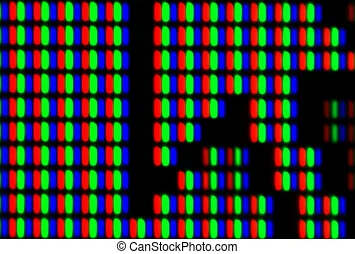

Original - altura, largura, canais: (254, 355, 3)


In [3]:
# ler e mostrar imagem:

img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/cores.jpg')
cv2_imshow(img)
print('Original - altura, largura, canais:', img.shape)

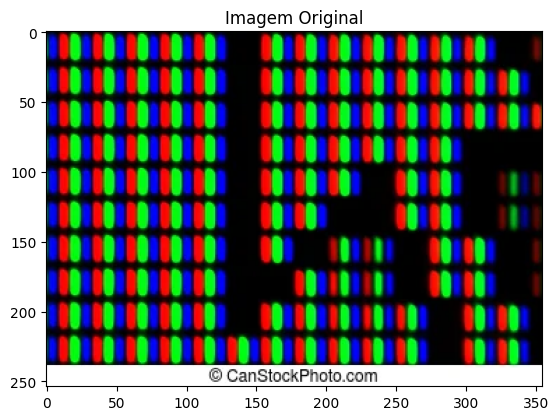

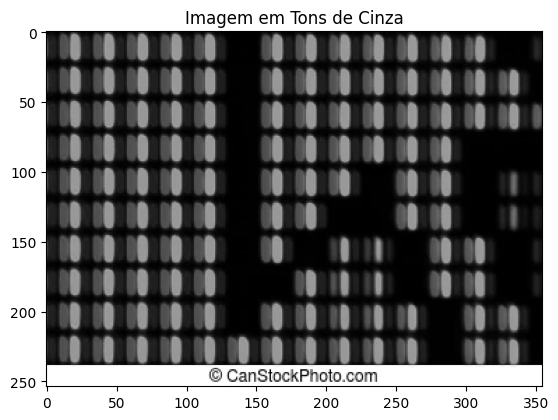

Tons de cinza - altura, largura, canais: (254, 355)


In [4]:
# colocando em tons de cinza

gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Imagem Original')
plt.show()

plt.imshow(gray_img, cmap='gray')
plt.title('Imagem em Tons de Cinza')
plt.show()

print('Tons de cinza - altura, largura, canais:', gray_img.shape)


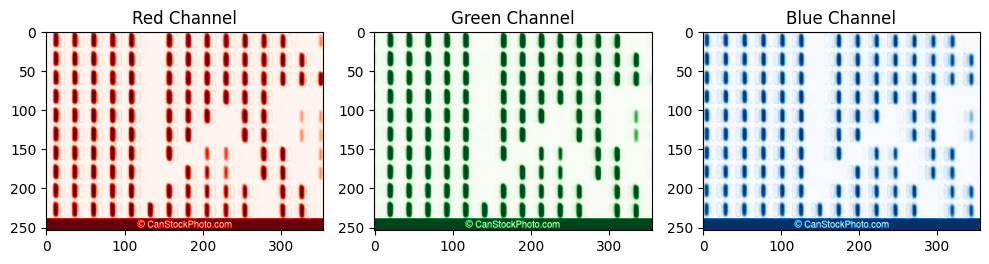

In [5]:




img_2 = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/cores.jpg')

# Split the image into color channels
channels = cv2.split(img_2)


# Show each channel separately
plt.figure(figsize=(10, 6))

plt.subplot(131)
plt.imshow(channels[2], cmap='Reds')
plt.title('Red Channel')

plt.subplot(132)
plt.imshow(channels[1], cmap='Greens')
plt.title('Green Channel')

plt.subplot(133)
plt.imshow(channels[0], cmap='Blues')
plt.title('Blue Channel')

plt.tight_layout()
plt.show()



# ATIVIDADE 02


ATIVIDADES PARA SEREM REALIZADAS
1. CALCULAR A INFORMAÇÃO ESPACIAL
2. EXPANSÃO E REDUÇÃO DE IMAGENS (4X)
MÉDIA, MEDIANA, MODA, VIZINHO MAIS PRÓXIMOS, BILINEAR, BICUBICA
3. AVALIAR USANDO PSNR E SSIM

In [6]:
# CALCULAR A INFORMAÇÃO ESPACIAL

"""
Para calcular a informação espacial de uma imagem, você pode usar a fórmula da entropia. 
Indica a quantidade de variação ou aleatoriedade nos valores dos pixels da imagem.

"""


def calcular_entropia(imagem):
    hist, _ = np.histogram(imagem.flatten(), bins=256, range=[0, 256])
    probabilidade = hist / np.sum(hist)
    probabilidade = probabilidade[probabilidade != 0]  # Remover valores de probabilidade zero
    entropia = -np.sum(probabilidade * np.log2(probabilidade))
    return entropia

img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/images.jpeg', cv2.IMREAD_GRAYSCALE)

entropia = calcular_entropia(img)
print('Entropia Espacial:', entropia)

Entropia Espacial: 6.414578280707156


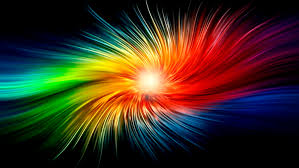

(168, 299, 3)
 


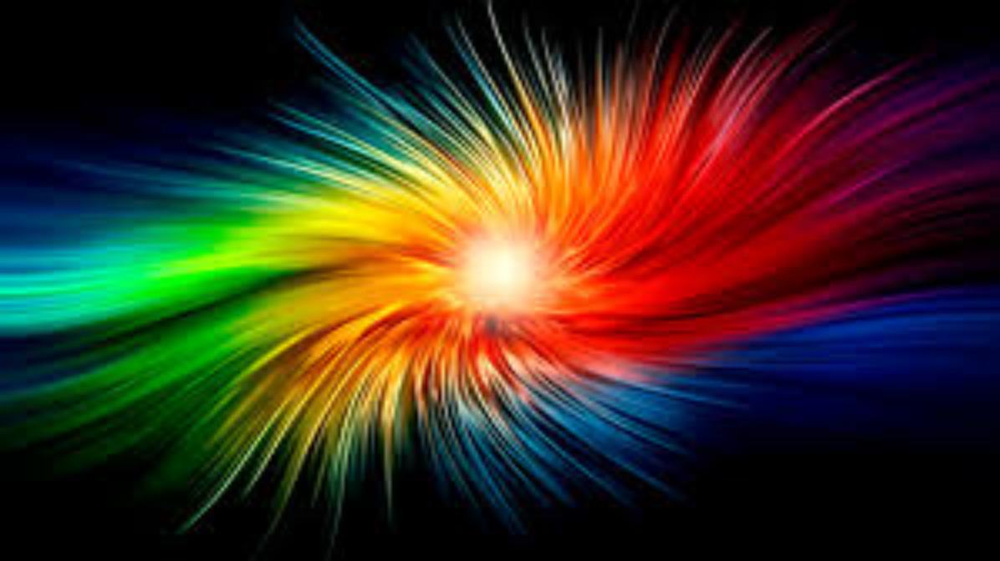

(672, 1196, 3)
 


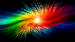

(42, 75, 3)


In [7]:
# EXPANSÃO E REDUÇÃO DE IMAGENS (4X)



# Carregar a imagem
img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/images.jpeg')

# Redimensionar para a expansão (4x maior)
expanded_img = cv2.resize(img, None, fx=4, fy=4, interpolation=cv2.INTER_LINEAR)

# Redimensionar para a redução (4x menor)
reduced_img = cv2.resize(img, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_LINEAR)

# Exibir as imagens

cv2_imshow(img)
print(img.shape)
print(" ")
cv2_imshow(expanded_img)
print(expanded_img.shape)
print(" ")
cv2_imshow(reduced_img)
print(reduced_img.shape)


In [8]:
# MÉDIA, MEDIANA E MODA


# Carregar a imagem em tons de cinza
img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/images.jpeg', cv2.IMREAD_GRAYSCALE)

# Calcular a média dos pixels
media = np.mean(img)

print('Média da imagem:', media)


# Calcular a mediana dos pixels
mediana = np.median(img)

print('Mediana da imagem:', mediana)

# Calcular a moda dos pixels
moda = mode(img, axis=None)

print('Moda da imagem:', moda[0])
print(" ")



Média da imagem: 49.581780538302276
Mediana da imagem: 23.0
Moda da imagem: [0]
 


<ipython-input-8-be1e4c55e30e>:19: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  moda = mode(img, axis=None)


imagem original: 


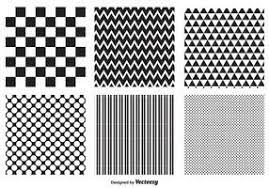

     
imagem interpolada: 


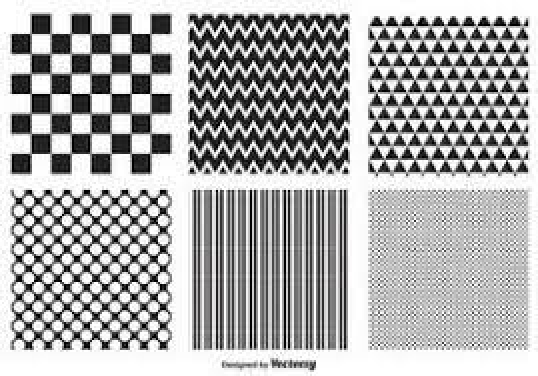

In [9]:
# INTERPOLAÇÃO POR VIZINHOS MAIS PRÓXIMOS
# gera distorção 
"""
 é uma técnica de interpolação utilizada para preencher valores ausentes ou ampliar/rescalar uma imagem. 
 Nesse método, o valor do pixel interpolado é atribuído com base nos valores dos pixels vizinhos mais próximos.
"""


# Carregar a imagem
img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/quadrados.jpeg')

# Definir o fator de escala
scale_factor = 2  # Fator de escala de 2

# Calcular as novas dimensões da imagem
new_width = int(img.shape[1] * scale_factor)
new_height = int(img.shape[0] * scale_factor)

# Redimensionar a imagem usando interpolação por vizinhos mais próximos
resized_img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_NEAREST)

# Exibir a imagem original e a imagem redimensionada

print('imagem original: ')
cv2_imshow(img)
print('     ')
print('imagem interpolada: ')
cv2_imshow(resized_img)


imagem original: 


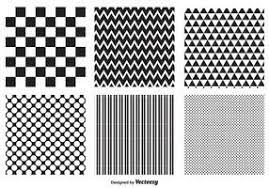

     
imagem interpolada: 


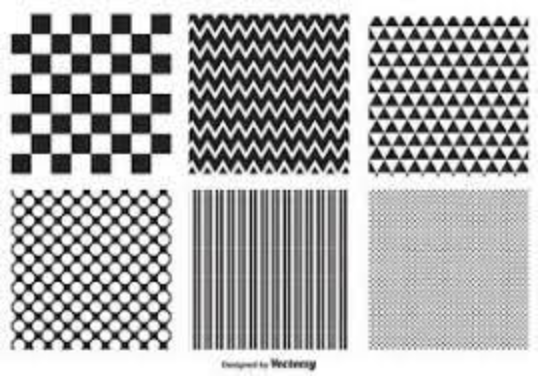

In [10]:
# INTERPOLAÇÃO BILINEAR
"""
 usada para redimensionar uma imagem,
 preenchendo os novos pixels com base nos valores dos pixels vizinhos. 
 resultado mais suave e visualmente agradável em comparação com a interpolação por vizinhos mais próximos.
"""


# Carregar a imagem
img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/quadrados.jpeg')

# Definir o fator de escala
scale_factor = 2  # Fator de escala de 2

# Calcular as novas dimensões da imagem
new_width = int(img.shape[1] * scale_factor)
new_height = int(img.shape[0] * scale_factor)

# Redimensionar a imagem usando interpolação bilinear
resized_img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_LINEAR)

# Exibir a imagem original e a imagem redimensionada

print('imagem original: ')
cv2_imshow(img)
print('     ')
print('imagem interpolada: ')
cv2_imshow(resized_img)


imagem original: 


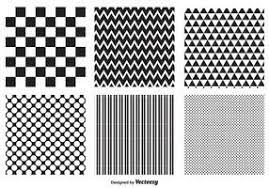

     
imagem interpolada: 


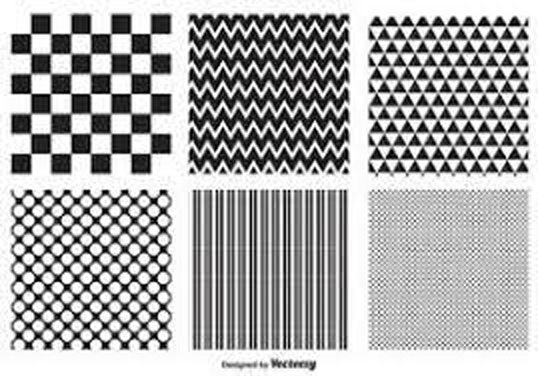

In [11]:
# INTERPOLAÇÃO BICÚBICA


# Carregar a imagem
img = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/quadrados.jpeg')

# Definir o fator de escala
scale_factor = 2  # Fator de escala de 2

# Calcular as novas dimensões da imagem
new_width = int(img.shape[1] * scale_factor)
new_height = int(img.shape[0] * scale_factor)

# Redimensionar a imagem usando interpolação bicúbica
resized_img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_CUBIC)

# Exibir a imagem original e a imagem redimensionada
print('imagem original: ')
cv2_imshow(img)
print('     ')
print('imagem interpolada: ')
cv2_imshow(resized_img)


In [12]:

def evaluate_similarity(img1_path, img2_path):
    # Carregar as imagens
    img1 = cv2.imread(img1_path)
    img2 = cv2.imread(img2_path)

    # Redimensionar as imagens para ter as mesmas dimensões (se necessário)
    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    # Converter as imagens para escala de cinza
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    # Calcular o SSIM entre as imagens em escala de cinza
    ssim_score = ssim(img1_gray, img2_gray)
    print("SSIM:", ssim_score)

    # Calcular o PSNR entre as imagens
    mse = np.mean((img1.astype(float) - img2.astype(float)) ** 2)
    psnr = 20 * np.log10(255.0 / np.sqrt(mse))
    print("PSNR:", psnr)

# Exemplo de uso
img1_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/quadrados.jpeg'
img2_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/rainbow.jpeg'

evaluate_similarity(img1_path, img2_path)




SSIM: 0.05234071318739034
PSNR: 4.52553581798308


# ATIVIDADE 03


1. Apresentar o Histograma das imagens selecionadas em aulas anteriores

2. Clarear e escurecer as imagens (usando dois valores de gamma), apresentando também o histograma
3. Binarizar as imagens originais e transformadas
4. Apresentar as imagens com os bits mais e menos significativos



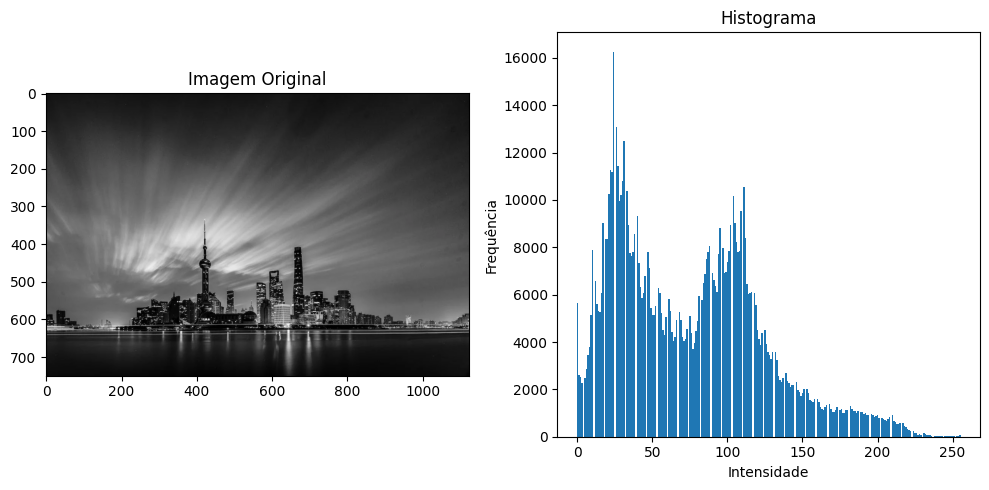

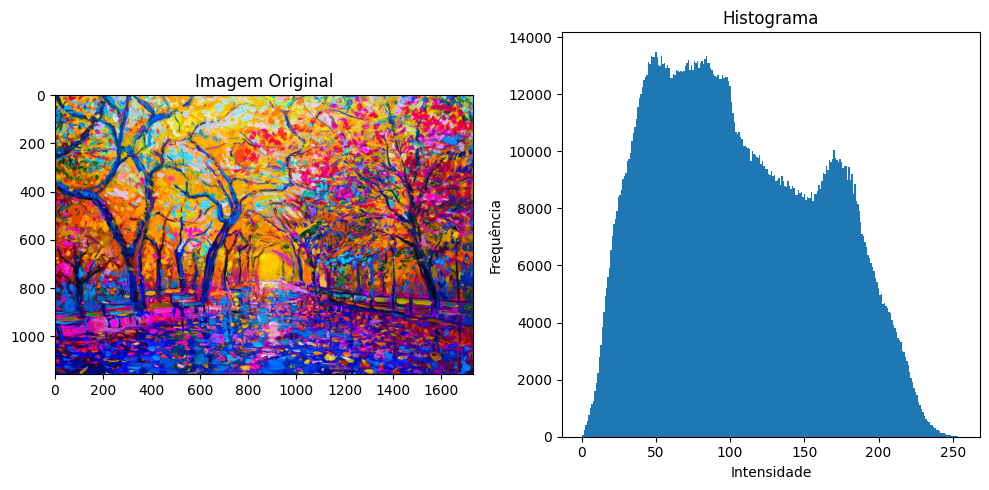

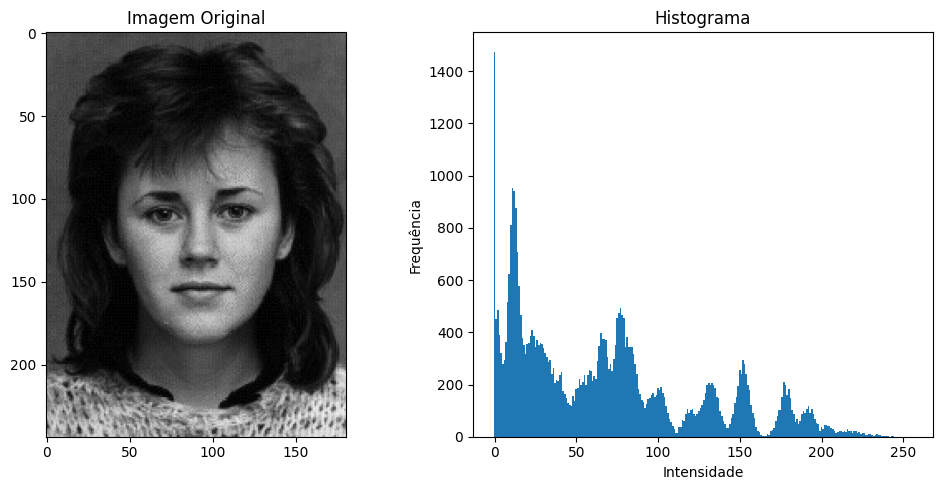

In [13]:
#  HISTOGRAMA

# https://www.ic.unicamp.br/~ra144681/misc/files/ApostilaProcDeImagesParteI.pdf

def plot_histogram_with_image(image_path):
    # Carregar a imagem
    img = cv2.imread(image_path)

    # Converter a imagem para escala de cinza
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Calcular o histograma discreto
    hist, bins = np.histogram(img_gray.flatten(), bins=np.arange(257))

    # Criar uma figura com duas subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

    # Exibir a imagem original na primeira subplot
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Imagem Original')

    # Exibir o histograma discreto na segunda subplot
    ax2.bar(bins[:-1], hist, width=1)
    ax2.set_title('Histograma')
    ax2.set_xlabel('Intensidade')
    ax2.set_ylabel('Frequência')

    # Ajustar o espaçamento entre as subplots
    plt.tight_layout()

    # Exibir a figura
    plt.show()

# Caminhos das imagens
image_path1 = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/predio.jpg'
image_path2 = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
image_path3 = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/rosto.jpg'
# Exibir imagem e histograma para a primeira imagem
plot_histogram_with_image(image_path1)


plot_histogram_with_image(image_path2)


plot_histogram_with_image(image_path3)


imagem original:


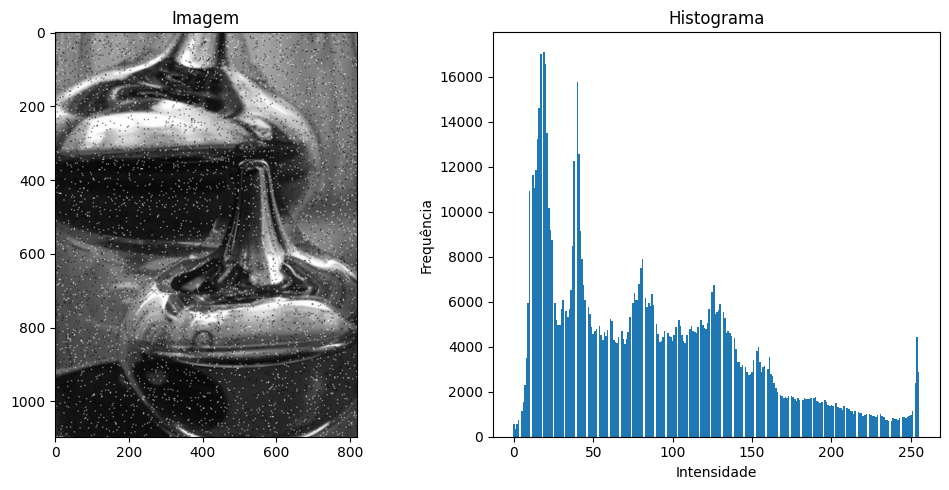

imagem clareada:


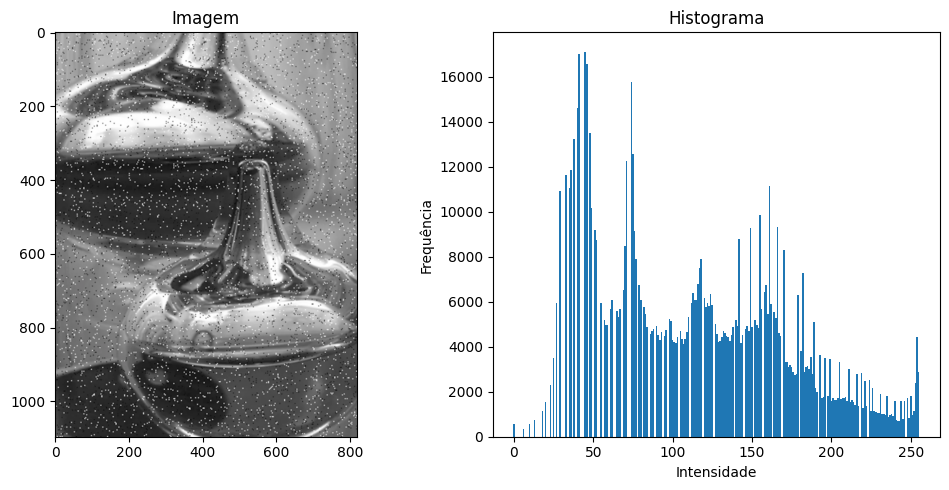

imagem escurecida:


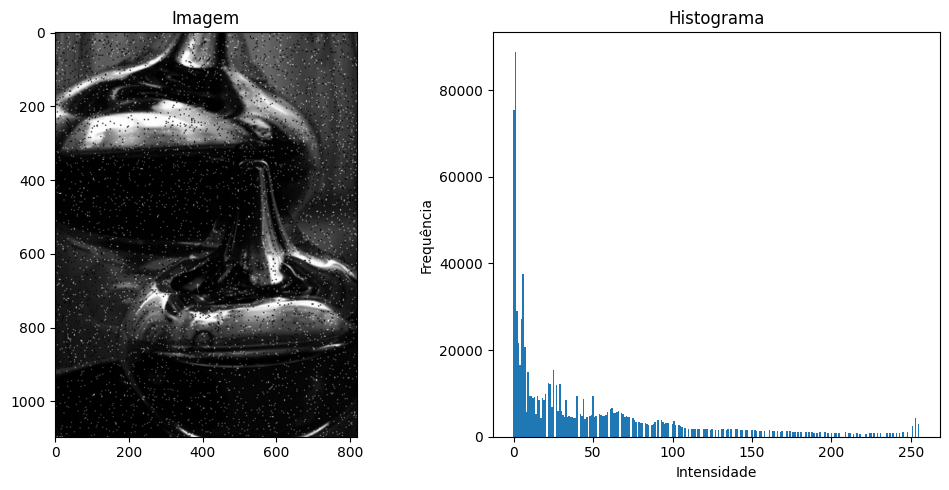

In [14]:
# CLAREAR E ESCURECER IMAGENS E SEUS RESPCTIVOS HISTOGRAMAS





def adjust_gamma(image, gamma):
    # Aplicar a transformação de gamma na imagem
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0, 256)]).astype(np.uint8)
    return cv2.LUT(image, table)

def plot_image_with_histogram(image):
    # Converter a imagem para escala de cinza
    img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calcular o histograma discreto
    hist, bins = np.histogram(img_gray.flatten(), bins=np.arange(257))

    # Criar uma figura com duas subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

    # Exibir a imagem na primeira subplot
    ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax1.set_title('Imagem')

    # Exibir o histograma discreto na segunda subplot
    ax2.bar(bins[:-1], hist, width=1)
    ax2.set_title('Histograma')
    ax2.set_xlabel('Intensidade')
    ax2.set_ylabel('Frequência')

    # Ajustar o espaçamento entre as subplots
    plt.tight_layout()

    # Exibir a figura
    plt.show()

# Carregar a imagem
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/ruido.png'
img = cv2.imread(image_path)

# Definir os valores de gamma para clarear e escurecer a imagem
gamma_light = 1.5  # Valor de gamma para clarear a imagem
gamma_dark = 0.5   # Valor de gamma para escurecer a imagem

# Clarear a imagem
img_light = adjust_gamma(img, gamma_light)

# Escurecer a imagem
img_dark = adjust_gamma(img, gamma_dark)

# Exibir as imagens e seus histogramas
print('imagem original:')
plot_image_with_histogram(img)
print('imagem clareada:')
plot_image_with_histogram(img_light)
print('imagem escurecida:')
plot_image_with_histogram(img_dark)


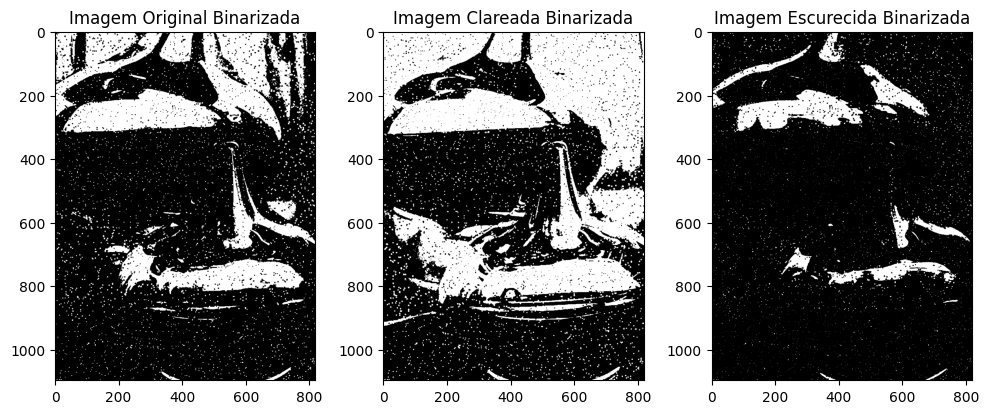

In [15]:
# BINARIZAR AS IMAGENS


def binarize_image(image, threshold):
    # Converter a imagem para escala de cinza
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Aplicar a binarização
    _, binarized_image = cv2.threshold(gray_image, threshold, 255, cv2.THRESH_BINARY)

    return binarized_image

# Carregar a imagem
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/ruido.png'
img = cv2.imread(image_path)

# Definir o valor de limite para a binarização
threshold = 127

# Binarizar a imagem original
binarized_original = binarize_image(img, threshold)

# Binarizar a imagem clareada
binarized_light = binarize_image(img_light, threshold)

# Binarizar a imagem escurecida
binarized_dark = binarize_image(img_dark, threshold)

# Exibir as imagens binarizadas
fig, axes = plt.subplots(1, 3, figsize=(10, 5))
axes[0].imshow(binarized_original, cmap='gray')
axes[0].set_title('Imagem Original Binarizada')
axes[1].imshow(binarized_light, cmap='gray')
axes[1].set_title('Imagem Clareada Binarizada')
axes[2].imshow(binarized_dark, cmap='gray')
axes[2].set_title('Imagem Escurecida Binarizada')
plt.tight_layout()
plt.show()


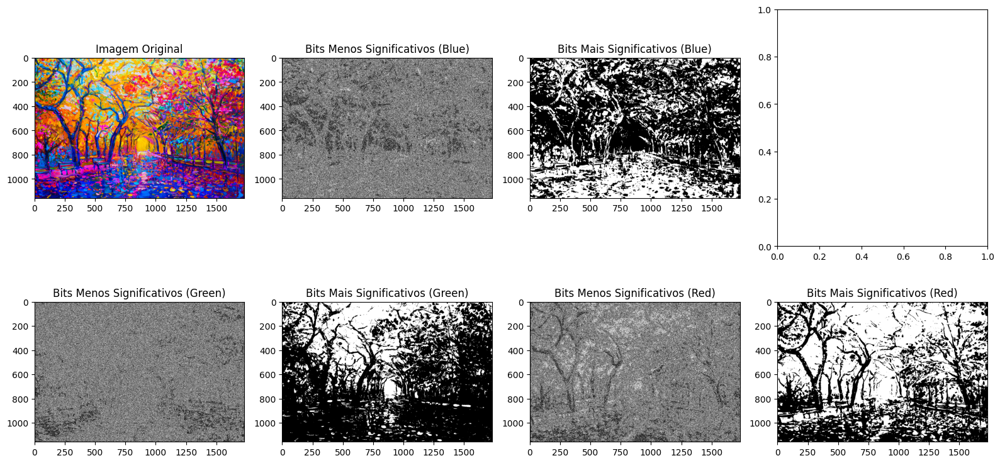

In [16]:
# BITS MAIS E MENOS SIGNIFICATIVOS


import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_least_significant_bits(image):
    # Extrair os canais de cor da imagem
    b, g, r = cv2.split(image)

    # Obter os bits mais e menos significativos
    lsb_b = np.bitwise_and(b, 1)
    lsb_g = np.bitwise_and(g, 1)
    lsb_r = np.bitwise_and(r, 1)
    msb_b = np.bitwise_and(b, 0b10000000)
    msb_g = np.bitwise_and(g, 0b10000000)
    msb_r = np.bitwise_and(r, 0b10000000)

    # Criar uma figura com subplots
    fig, axes = plt.subplots(2, 4, figsize=(16, 8))
    
    # Exibir a imagem original
    axes[0, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0, 0].set_title('Imagem Original')

    # Exibir os canais de cor
    axes[0, 1].imshow(lsb_b, cmap='gray')
    axes[0, 1].set_title('Bits Menos Significativos (Blue)')
    axes[0, 2].imshow(msb_b, cmap='gray')
    axes[0, 2].set_title('Bits Mais Significativos (Blue)')

    axes[1, 0].imshow(lsb_g, cmap='gray')
    axes[1, 0].set_title('Bits Menos Significativos (Green)')
    axes[1, 1].imshow(msb_g, cmap='gray')
    axes[1, 1].set_title('Bits Mais Significativos (Green)')

    axes[1, 2].imshow(lsb_r, cmap='gray')
    axes[1, 2].set_title('Bits Menos Significativos (Red)')
    axes[1, 3].imshow(msb_r, cmap='gray')
    axes[1, 3].set_title('Bits Mais Significativos (Red)')

    # Ajustar o espaçamento entre os subplots
    plt.tight_layout()

    # Exibir a figura
    plt.show()


# Carregar a imagem
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
image = cv2.imread(image_path)

# Visualizar os bits mais e menos significativos
visualize_least_significant_bits(image)



# ATIVIDADE 04


1. Estudar a equação que passa de RGB para tons de cinza -- testar e comparar usando a formula e a média
(https://tutoriais.edu.lat/pub/dip/grayscale-to-rgb-conversion/conversao-de-tons-de-cinza-para-rgb)
2. Converter as imagens de RGB para HSI
3. Identificar as cores que tem na imagem (escolhendo as doze cores principais e apresentar de forma de histograma)
4. Identificar os objetos usando as cores
5. Identificar a intensidade das imagens usadas para apresentar a mudança de contraste


[[[  0   0 255]]]


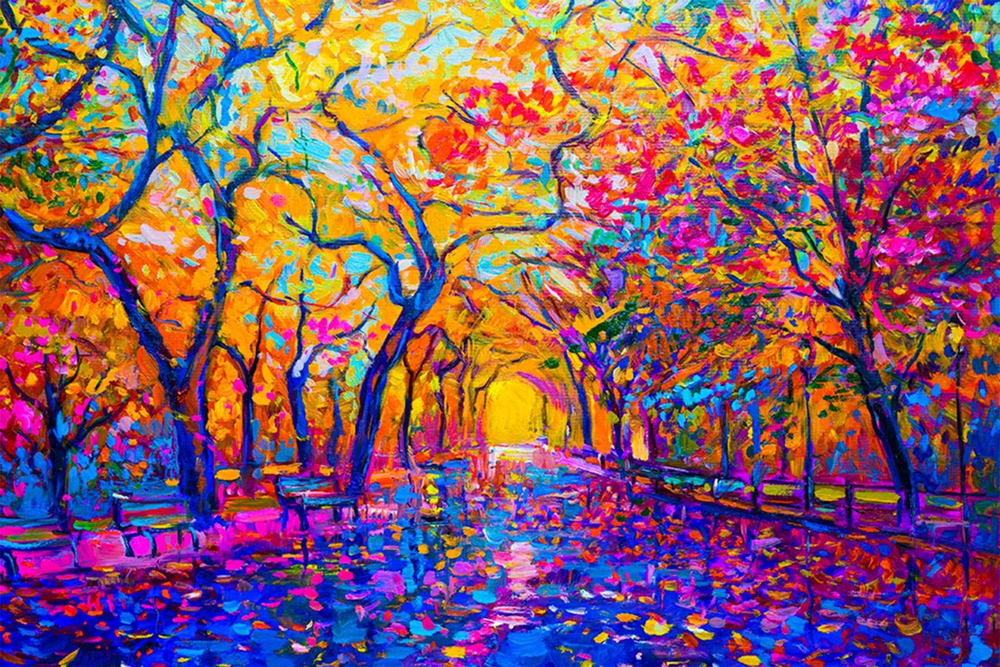

In [17]:
color = np.uint8([[[255,255,255 ]]])
hsv_color = cv2.cvtColor(color,cv2.COLOR_BGR2HSV)
print(hsv_color)

img_4 = cv2.imread('/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg')
cv2_imshow(img_4)

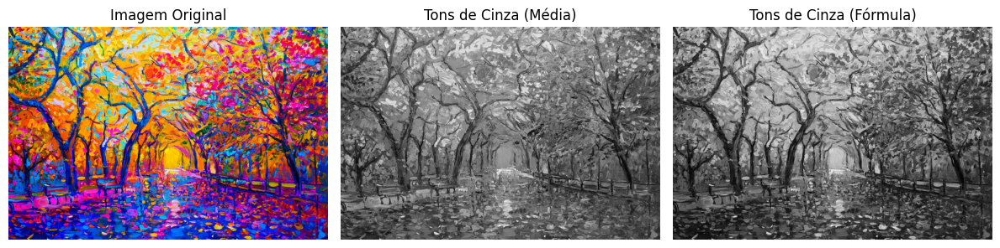

In [18]:
# TONS DE CINZA - FÓRMULA E MÉDIA

def convert_to_grayscale_formula(image):
    # Converter a imagem para tons de cinza usando a fórmula
    gray_formula = 0.299 * image[:, :, 2] + 0.587 * image[:, :, 1] + 0.114 * image[:, :, 0]
    gray_formula = gray_formula.astype(np.uint8)  # Converter para o tipo de dados uint8
    
    return gray_formula

# Carregar a imagem
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
image = cv2.imread(image_path)

# Converter a imagem para tons de cinza usando a média dos canais de cores
gray_mean = np.mean(image, axis=2).astype(np.uint8)

# Converter a imagem para tons de cinza usando a fórmula de conversão
gray_formula = convert_to_grayscale_formula(image)

# Exibir as imagens
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axes[0].set_title('Imagem Original')
axes[0].axis('off')
axes[1].imshow(gray_mean, cmap='gray')
axes[1].set_title('Tons de Cinza (Média)')
axes[1].axis('off')
axes[2].imshow(gray_formula, cmap='gray')
axes[2].set_title('Tons de Cinza (Fórmula)')
axes[2].axis('off')

plt.tight_layout()
plt.show()


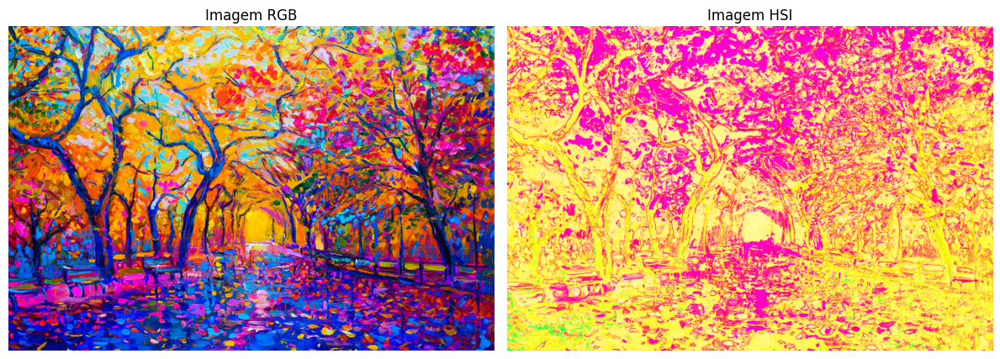

In [19]:
# Converter as imagens de RGB para HSI


def rgb_to_hsi(image):
    # Normalizar os valores dos canais de cores
    image_norm = image.astype(np.float32) / 255.0

    # Separar os canais de cores normalizados
    R, G, B = image_norm[:, :, 0], image_norm[:, :, 1], image_norm[:, :, 2]

    # Calcular o matiz (H)
    numerator = 0.5 * ((R - G) + (R - B))
    denominator = np.sqrt((R - G) ** 2 + (R - B) * (G - B))
    H = np.arccos(np.clip(numerator / (denominator + 1e-8), -1, 1))

    # Calcular a saturação (S)
    S = 1 - 3 * np.minimum(R, np.minimum(G, B))

    # Calcular a intensidade (I)
    I = (R + G + B) / 3

    # Ajustar o valor do matiz para o intervalo [0, 360]
    H *= 180 / np.pi
    H[H < 0] += 360

    # Criar uma imagem HSI
    hsi_image = np.zeros_like(image_norm)
    hsi_image[:, :, 0] = H
    hsi_image[:, :, 1] = S
    hsi_image[:, :, 2] = I

    return hsi_image

# Carregar a imagem RGB do drive
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
image_rgb = cv2.imread(image_path)

# Converter a imagem RGB para HSI
image_hsi = rgb_to_hsi(image_rgb)

# Exibir as imagens RGB e HSI
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(cv2.cvtColor(image_rgb, cv2.COLOR_BGR2RGB))
axes[0].set_title('Imagem RGB')
axes[0].axis('off')
axes[1].imshow(image_hsi)
axes[1].set_title('Imagem HSI')
axes[1].axis('off')

plt.tight_layout()
plt.show()


Cores identificadas na imagem:


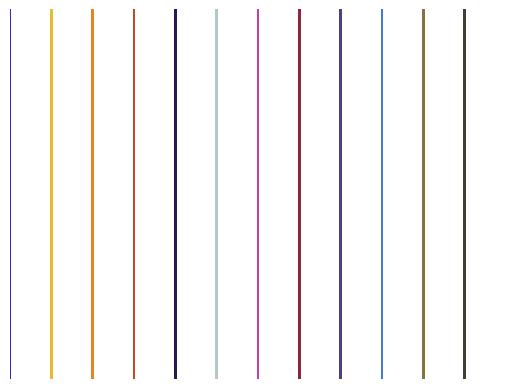

In [20]:
# Identificar as cores que tem na imagem
# (escolhendo as doze cores principais e apresentar de forma de histograma)




def identify_main_colors(image, num_colors):
    # Redimensionar a imagem para uma largura fixa para melhor desempenho
    width = 400
    height = int(image.shape[0] * (width / image.shape[1]))
    image_resized = cv2.resize(image, (width, height))

    # Converter a imagem para o espaço de cor Lab
    image_lab = cv2.cvtColor(image_resized, cv2.COLOR_BGR2Lab)

    # Achatando a imagem para um vetor 2D
    pixels = image_lab.reshape((-1, 3))

    # Realizar a clusterização dos pixels usando o algoritmo K-Means
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    _, labels, centers = cv2.kmeans(pixels.astype(np.float32), num_colors, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    # Contar a quantidade de pixels em cada cluster
    counts = np.bincount(labels.flatten())

    # Ordenar os centros dos clusters pelo número de pixels em cada cluster
    ordered_centers = centers[np.argsort(counts)[::-1]]

    # Converter os centros dos clusters para o espaço de cor RGB
    colors_rgb = cv2.cvtColor(ordered_centers.reshape((-1, 1, 3)).astype(np.uint8), cv2.COLOR_Lab2RGB)

    return colors_rgb

def plot_color_histogram(colors_rgb):
    # Criar uma figura para o histograma de cores
    fig, ax = plt.subplots()

    # Calcular a largura das barras do histograma
    bar_width = 0.8 / len(colors_rgb)

    # Plotar as barras do histograma
    for i, color_rgb in enumerate(colors_rgb):
        ax.bar(i, 1, width=bar_width, color=color_rgb / 255)

    # Configurar os eixos do histograma
    ax.set_xlim(0, len(colors_rgb))
    ax.set_ylim(0, 1)
    ax.axis('off')

    # Exibir a figura
    plt.show()

# Carregar a imagem do drive
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'

# Identificar as cores principais na imagem
num_colors = 12
colors_rgb = identify_main_colors(image, num_colors)

print('Cores identificadas na imagem:')
# Plotar o histograma de cores
plot_color_histogram(colors_rgb)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


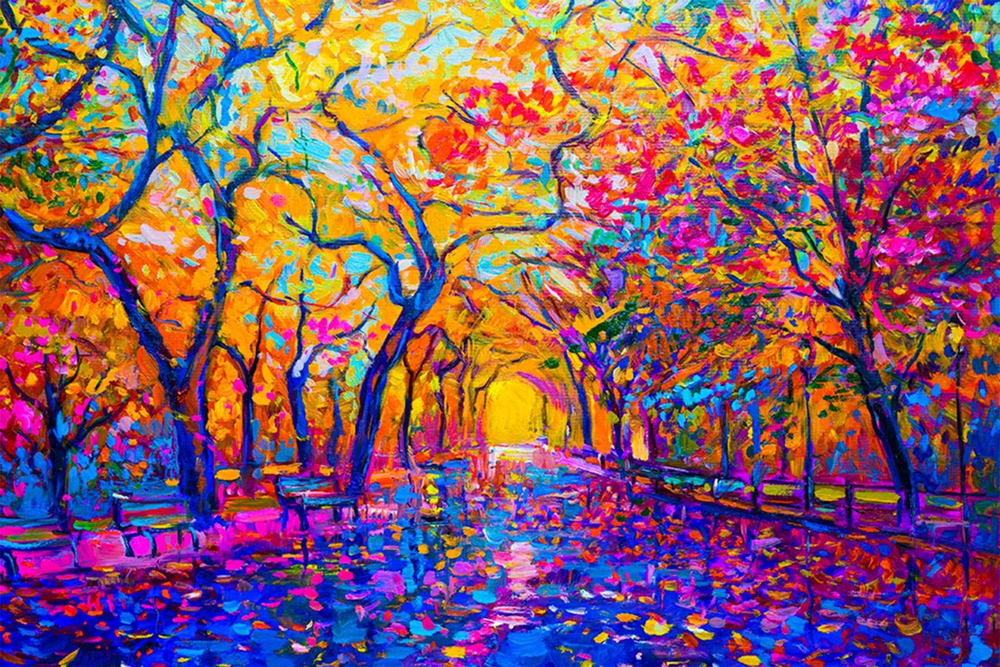

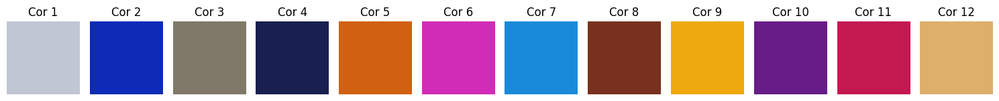

In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Carregar a imagem do drive
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
image = cv2.imread(image_path)

# Converter a imagem para o espaço de cor desejado (por exemplo, RGB)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Redimensionar a imagem para uma matriz unidimensional
pixels = image_rgb.reshape(-1, 3)

# Definir o número de cores principais desejadas
num_colors = 12

# Aplicar o algoritmo K-means para agrupar os pixels em cores principais
kmeans = KMeans(n_clusters=num_colors)
kmeans.fit(pixels)

# Obter as cores principais encontradas pelo algoritmo K-means
main_colors = kmeans.cluster_centers_.astype(int)

# Mostrar as 12 principais cores
fig, ax = plt.subplots(1, num_colors, figsize=(15, 2))

for i in range(num_colors):
    color_patch = np.full((10, 10, 3), main_colors[i], dtype=np.uint8)
    ax[i].imshow(color_patch)
    ax[i].set_title(f'Cor {i+1}')
    ax[i].axis('off')
cv2_imshow(image)
plt.tight_layout()
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


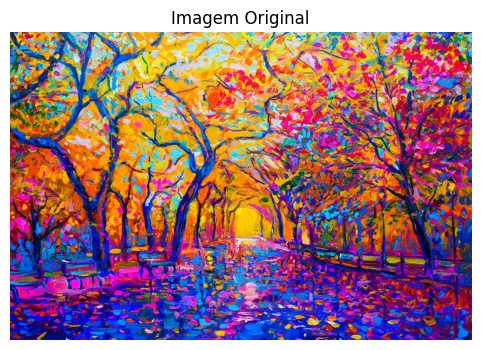

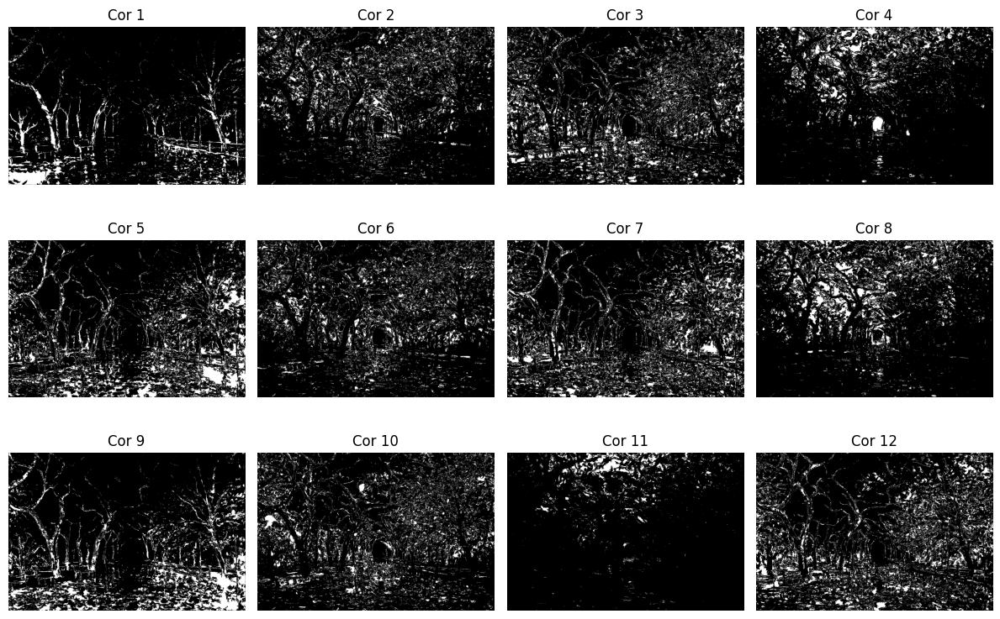

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Carregar a imagem do drive
image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
image = cv2.imread(image_path)

# Converter a imagem para escala de cinza
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Definir o número de cores principais desejadas
num_colors = 12

# Aplicar o algoritmo K-means na imagem em escala de cinza
kmeans = KMeans(n_clusters=num_colors)
kmeans.fit(image_gray.reshape(-1, 1))

# Obter os valores médios encontrados pelo algoritmo K-means
mean_values = kmeans.cluster_centers_.astype(int).squeeze()

# Segmentar a imagem original para cada valor médio
segmented_images = []
for value in mean_values:
    # Criar uma máscara para o valor médio atual
    mask = cv2.inRange(image_gray, np.array([value-10]), np.array([value+10]))
    
    # Encontrar os contornos dos objetos na máscara
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Criar uma imagem em branco com o mesmo tamanho da imagem original
    segmented_image = np.zeros_like(image)
    
    # Desenhar os contornos dos objetos na imagem em branco
    cv2.drawContours(segmented_image, contours, -1, (255, 255, 255), thickness=cv2.FILLED)
    
    # Adicionar a imagem segmentada à lista de imagens segmentadas
    segmented_images.append(segmented_image)

# Mostrar a imagem original
plt.figure(figsize=(6, 4))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Imagem Original')
plt.axis('off')
plt.show()

# Mostrar as imagens segmentadas para cada valor médio
fig, axs = plt.subplots(3, 4, figsize=(12, 8))
axs = axs.ravel()

for i, segmented_image in enumerate(segmented_images):
    axs[i].imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
    axs[i].set_title(f'Cor {i+1}')
    axs[i].axis('off')

plt.tight_layout()
plt.show()



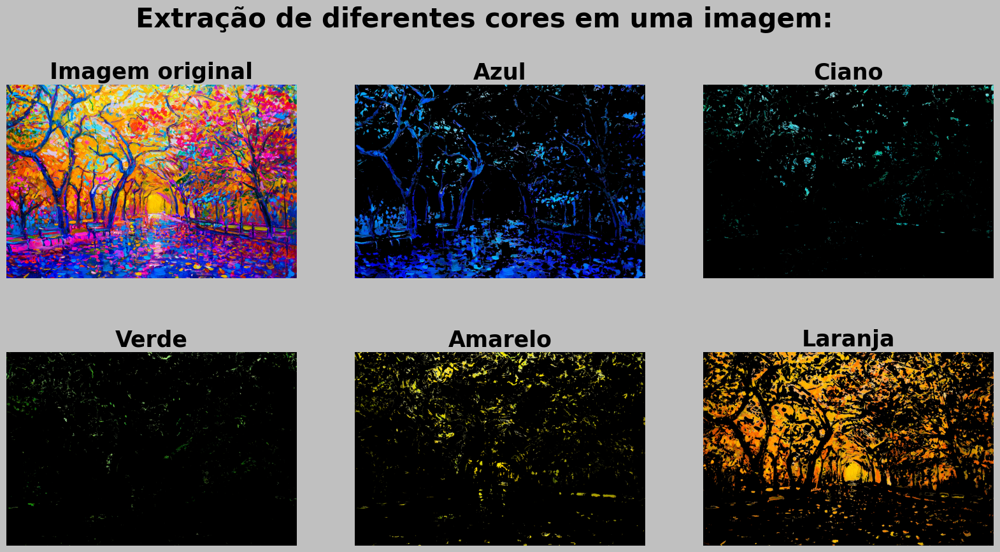

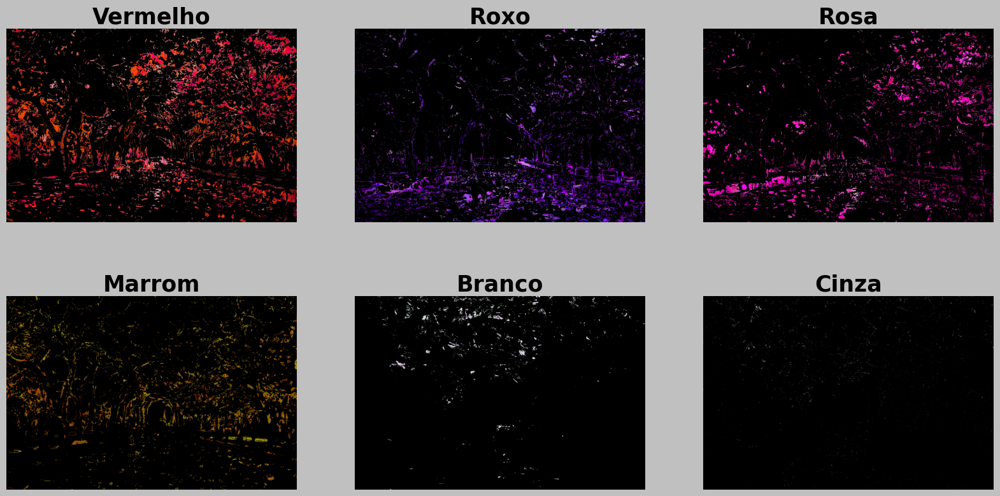

In [23]:
#Identificar intervalo de cores usando HSV


image_path = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/paint.jpg'
img_at4 = cv2.imread(image_path)


def show_img_with_matplotlib(color_img, title, pos):
    """Shows an image using matplotlib capabilities"""

    # Convert BGR image to RGB
    img_RGB = color_img[:, :, ::-1]

    ax = plt.subplot(2, 3, pos)
    plt.imshow(img_RGB)
    plt.title(title,fontsize=25,fontweight='bold')
    plt.axis('off')
    
# Crie as dimensões da figura e defina o título:
fig = plt.figure(figsize=(20, 10))
plt.suptitle("Extração de diferentes cores em uma imagem:", fontsize=30, fontweight='bold')
fig.patch.set_facecolor('silver')

#Identificando azul

#Conversão para HSI
hsv_img = cv2.cvtColor(img_at4, cv2.COLOR_BGR2HSV)

#Máscara para cor vermelha          #soma de máscaras
lower_red1 = np.array([165,50,50])
upper_red1 = np.array([179,255,255])
lower_red2 = np.array([0,50,50])
upper_red2 = np.array([10,255,255])
#Máscara para cor rosa
lower_pink = np.array([150,50,50])
upper_pink = np.array([165,255,255])
#Máscara para cor roxa
lower_purple = np.array([125,50,50])
upper_purple = np.array([150,255,255])
#Máscara para cor azul
lower_blue = np.array([95,70,50])
upper_blue = np.array([125,255,255])
#Máscara para cor ciano
lower_ciano = np.array([70,70,50])
upper_ciano = np.array([95,255,255])
#Máscara para cor verde
lower_green = np.array([40,70,50])
upper_green = np.array([70,255,255])
#Máscara para cor amarela
lower_yellow = np.array([25,50,50])
upper_yellow = np.array([40,255,255])
#Máscara para cor laranja
lower_orange = np.array([10,50,50])
upper_orange = np.array([25,255,255])
#Máscara para cor marrom [[[ 15 255 156]]]
lower_brown = np.array([10,128,38])
upper_brown = np.array([30,255,190])
#Máscara para cor branca
lower_white = np.array([0,0,200])
upper_white = np.array([179,38,255])
#Máscara para cor cinza
lower_grey = np.array([0,0,50])
upper_grey = np.array([179,38,200])
#Máscara para cor preta
lower_black = np.array([0,0,0])
upper_black = np.array([179,38,50])


#masking the HSV image to get only selected colors
imagemask_blue = cv2.inRange(hsv_img, lower_blue, upper_blue)
res_blue = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_blue)

imagemask_green = cv2.inRange(hsv_img, lower_green, upper_green)
res_green = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_green)

imagemask_yellow = cv2.inRange(hsv_img, lower_yellow, upper_yellow)
res_yellow = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_yellow)

imagemask_orange = cv2.inRange(hsv_img, lower_orange, upper_orange)
res_orange = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_orange)

imagemask_red1 = cv2.inRange(hsv_img, lower_red1, upper_red1)
imagemask_red2 = cv2.inRange(hsv_img, lower_red2, upper_red2)
#imagemask_red = cv2.bitwise_or(imagemask_red1, imagemask_red2)  #tanto faz usar função lógica OR ou somar diretamente
imagemask_red = imagemask_red1 + imagemask_red2
res_red = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_red)

imagemask_ciano = cv2.inRange(hsv_img, lower_ciano, upper_ciano)
res_ciano = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_ciano)

imagemask_purple = cv2.inRange(hsv_img, lower_purple, upper_purple)
res_purple = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_purple)

imagemask_pink = cv2.inRange(hsv_img, lower_pink, upper_pink)
res_pink = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_pink)

imagemask_brown = cv2.inRange(hsv_img, lower_brown, upper_brown)
res_brown = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_brown)

imagemask_white = cv2.inRange(hsv_img, lower_white, upper_white)
res_white = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_white)

imagemask_grey = cv2.inRange(hsv_img, lower_grey, upper_grey)
res_grey = cv2.bitwise_and(img_at4,img_at4, mask= imagemask_grey)

# Plot all the images:
show_img_with_matplotlib(img_at4, "Imagem original", 1)
show_img_with_matplotlib(res_blue, "Azul", 2)
show_img_with_matplotlib(res_ciano, "Ciano", 3)
show_img_with_matplotlib(res_green, "Verde", 4)
show_img_with_matplotlib(res_yellow, "Amarelo", 5)
show_img_with_matplotlib(res_orange, "Laranja", 6)

# Show the Figure:
plt.show()

# Crie as dimensões da figura e defina o título:
fig2 = plt.figure(figsize=(20, 10))
fig2.patch.set_facecolor('silver')

# Plot all the images:
show_img_with_matplotlib(res_red, "Vermelho", 1)
show_img_with_matplotlib(res_purple, "Roxo", 2)
show_img_with_matplotlib(res_pink, "Rosa", 3)
show_img_with_matplotlib(res_brown, "Marrom", 4)
show_img_with_matplotlib(res_white, "Branco", 5)
show_img_with_matplotlib(res_grey, "Cinza", 6)

# Show the Figure:
plt.show()

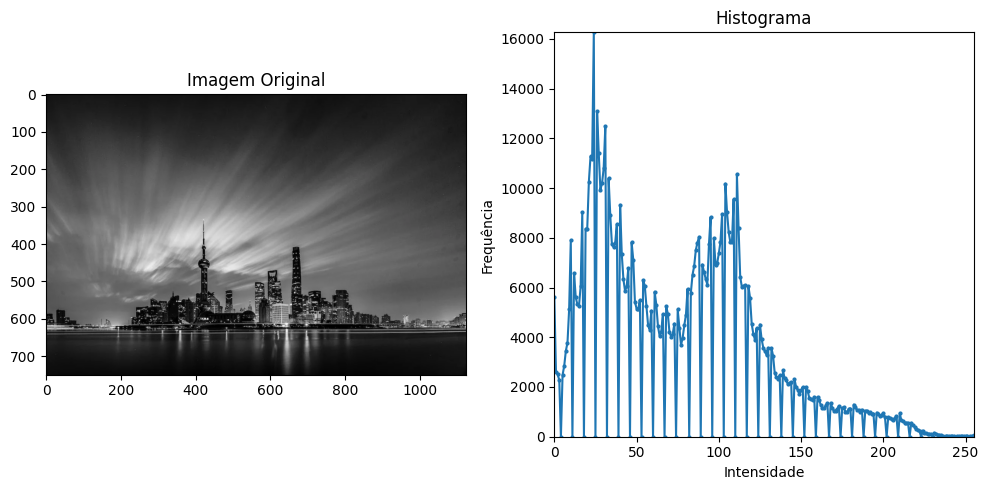

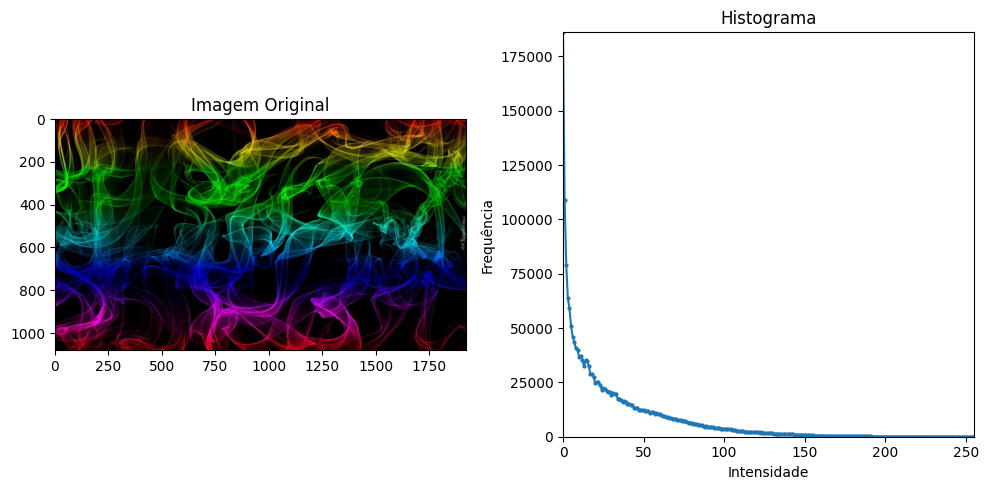

In [24]:
#  Identificar a intensidade das imagens usadas para apresentar a mudança de contraste


# Função para calcular e exibir o histograma de uma imagem em escala de cinza
def plot_histogram_with_image(image):
    # Converter a imagem para escala de cinza
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calcular o histograma
    hist = cv2.calcHist([gray], [0], None, [256], [0, 256])
    
    # Criar uma figura com duas subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    
    # Exibir a imagem original na primeira subplot
    ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax1.set_title('Imagem Original')
    
    # Exibir o histograma na segunda subplot
    ax2.plot(hist, marker='o', markersize=2)
    ax2.set_title('Histograma')
    ax2.set_xlabel('Intensidade')
    ax2.set_ylabel('Frequência')
    ax2.set_xlim([0, 255])
    ax2.set_ylim([0, np.max(hist)])
    
    # Ajustar o espaçamento entre as subplots
    plt.tight_layout()
    
    # Exibir a figura
    plt.show()

# Caminhos das imagens no Google Drive
image_path1 = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/predio.jpg'
image_path2 = '/content/drive/MyDrive/DISCIPLINAS/IMAGENS_MÉDICAS/color.jpg'

# Carregar as imagens
image1 = cv2.imread(image_path1)
image2 = cv2.imread(image_path2)

# Exibir a imagem original e o histograma
plot_histogram_with_image(image1)
plot_histogram_with_image(image2)


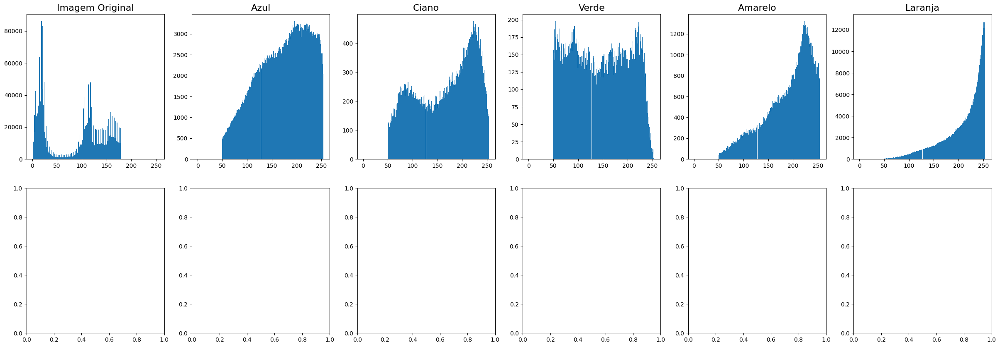

In [25]:

# Cria as dimensões da figura
fig, ax = plt.subplots(2, 6, figsize=(30,10)) 


#convertendo em HSV novamente para poder plotar o gráfico
ax[0,0].set_title('Imagem Original', fontsize=16)
ax[0,0].hist(hsv_img[:,:,0].ravel(),179,[1,254]);
ax[0,1].set_title('Azul', fontsize=16)
ax[0,1].hist(cv2.cvtColor(res_blue, cv2.COLOR_BGR2HSV)[:,:,2].ravel(),255,[1,254]);
ax[0,2].set_title('Ciano', fontsize=16)
ax[0,2].hist(cv2.cvtColor(res_ciano, cv2.COLOR_BGR2HSV)[:,:,2].ravel(),255,[1,254]);
ax[0,3].set_title('Verde', fontsize=16)
ax[0,3].hist(cv2.cvtColor(res_green, cv2.COLOR_BGR2HSV)[:,:,2].ravel(),255,[1,254]);
ax[0,4].set_title('Amarelo', fontsize=16)
ax[0,4].hist(cv2.cvtColor(res_yellow, cv2.COLOR_BGR2HSV)[:,:,2].ravel(),255,[1,254]);
ax[0,5].set_title('Laranja', fontsize=16)
ax[0,5].hist(cv2.cvtColor(res_orange, cv2.COLOR_BGR2HSV)[:,:,2].ravel(),255,[1,254]);


plt.show()